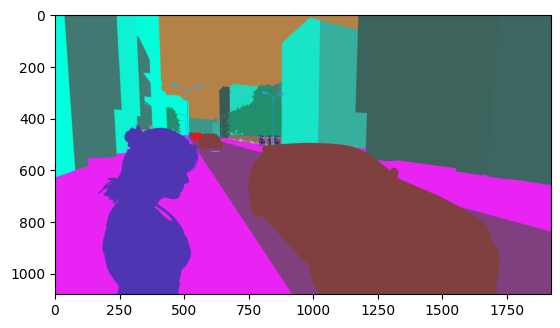

In [1]:
import cv2

# Load an image from file
img = cv2.imread('img.png')

# Display the image
import matplotlib.pyplot as plt
plt.imshow(img)
plt.show()







In [2]:
from PIL import Image, ImageDraw, ImageFont,ImageColor
import numpy as np
import matplotlib.pyplot as plt

# load image
img = Image.open('img.png')  
print(img.size)
#img = img.resize((img.size[0] // 6 , img.size[1] // 6))
img = np.array(img) 
print(np.shape(img))


(1920, 1080)
(1080, 1920, 3)


In [3]:
def rgb_to_hex(rgb):
    """Converts an RGB tuple to its corresponding hexadecimal format."""
    r, g, b = rgb
    hex_value = "#{:02x}{:02x}{:02x}".format(r, g, b)
    return hex_value

In [4]:
# use nested list comprehension to apply the function to each element in the 2D list
new_list = [[rgb_to_hex(img[row][col]) for col in range(len(img[row]))] for row in range(len(img))]

# print the new list
#print(new_list)

In [5]:
new_list    

[['#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#dbff00',
  '#a6bc20',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',
  '#717940',

In [6]:
width, height = len(new_list[0]), len(new_list)
image = Image.new("RGB", (width, height)) 

print(width,height)

1920 1080


In [7]:
 
i = 0 
j = 0
# set the color of each pixel in the image based on the values in the 2D list
for x in range(width): 
    #print(i) 
    for y in range(height):
        hex_value = new_list[y][x] 

        image.putpixel((x, y), ImageColor.getcolor(hex_value, "RGB")) 
        #print(j,hex_value) 
        #j = j + 1
    #i = i+1

# show the image
image.show()

In [8]:
def is_similar_color(hex_color1, hex_color2, offset):
    """Detects if two hex color values are similar with a certain offset.

    Args:
        hex_color1 (str): The first hex color value.
        hex_color2 (str): The second hex color value.
        offset (int): The maximum difference allowed between the RGB values of the two colors.

    Returns:
        bool: True if the two colors are similar, False otherwise.
    """
    # Convert the hex color values to RGB tuples
    hex_color1 = hex_color1[1:]
    hex_color2 = hex_color2[1:]

    rgb_color1 = tuple(int(hex_color1[i:i+2], 16) for i in (0, 2, 4))
    rgb_color2 = tuple(int(hex_color2[i:i+2], 16) for i in (0, 2, 4))

    # Check if the difference between the RGB values of the two colors is within the offset
    for i in range(3):
        if abs(rgb_color1[i] - rgb_color2[i]) > offset:
            return False

    return True


In [9]:
is_similar_color('#404080','#00008e',70)

True

In [10]:
import json

# Load the JSON data
with open('text.json', 'r') as f:
    data = json.load(f)

# Define the hex color to search for
#hex_color = '#00008e'

labeled_lst = []
for row in range(len(new_list)): 
    new_element = []
    for col in range(len(new_list[0])): 
        # Loop through the objectsToChange list and search for the color 
        found = False 
        for obj in data['objectsToChange']:
            if is_similar_color(obj['color'] , new_list[row][col] , 70) == True:
                # Color found, return the corresponding label
                #print(obj['label']) 
                found = True
                new_element.append((obj['color'],obj['label'])) 
                break
            #elif: 
                #use the offset thingy 
            else :  
                #new_element.append((new_list[row][col],"none")) 
                continue 
        if found == False :
            new_element.append((new_list[row][col],"none")) 
            
    labeled_lst.append(new_element) 






In [ ]:
print(len(labeled_lst),len(labeled_lst[0]))

In [ ]:
labeled_lst

In [ ]:
i = 0 
j = 0
# set the color of each pixel in the image based on the values in the 2D list
for x in range(width): 
    #print(i) 
    for y in range(height):
        hex_value = labeled_lst[y][x][0] 

        image.putpixel((x, y), ImageColor.getcolor(hex_value, "RGB")) 
        #print(j,hex_value) 
        #j = j + 1
    #i = i+1

# show the image
image.show()

In [11]:
def value_exists(value, arr):
    for row in arr:
        if value in row:
            return True
    return False


In [ ]:
value_exists( ('#00008e', 'Vehicle') , labeled_lst )

In [12]:
def get_bounding_rectangle(coordinates):
    # Get the minimum and maximum x and y coordinates
    min_x = min(coord[0] for coord in coordinates)
    min_y = min(coord[1] for coord in coordinates)
    max_x = max(coord[0] for coord in coordinates)
    max_y = max(coord[1] for coord in coordinates)

    # Return the bounding rectangle as a tuple
    return (min_x, min_y, max_x, max_y)

In [ ]:
print(np.shape(labeled_lst))

In [14]:
def find_islands2(arr):
    islands = []
    visited = set()
    for i in range(len(arr)):
        for j in range(len(arr[0])):
            if (i, j) not in visited: 
                if arr[i][j][1] != 'none' and arr[i][j][1] != 'Object' :
                    island = []
                    queue = [(i, j)]
                    visited.add((i, j))
                    while queue:
                        x, y = queue.pop(0)
                        island.append((x, y))
                        for dx, dy in [(0, 1), (0, -1), (1, 0), (-1, 0)]:
                            nx, ny = x + dx, y + dy##
                            if 0 <= nx < len(arr) and 0 <= ny < len(arr[0]) and (nx, ny) not in visited and arr[nx][ny] == arr[i][j]:
                                queue.append((nx, ny))
                                visited.add((nx, ny)) 
                    if len(island) >= 8:
                        islands.append(island)
                
    return islands

In [20]:
islands = find_islands2(labeled_lst) 

In [ ]:
len(islands)

In [ ]:
islands[0]

In [15]:
test = [labeled_lst[i][j] for i,j in islands[54]]
print(test)


NameError: name 'islands' is not defined

In [ ]:
test

In [ ]:
print(img[446][701],img[447][701],img[450][701])
print(islands[80])
print(labeled_lst[450][702])

In [ ]:
# Display the image
import matplotlib.pyplot as plt
plt.imshow(img)
plt.show()

In [16]:
# Open the JSON file
with open('./annotation.json', 'r') as f:
    # Load the JSON data from the file
    data = json.load(f)

# Access the data
info = data['info']
licenses = data['licenses']
categories = data['categories']
images = data['images']
annotations = data['annotations'] 



In [17]:
def shoelace_formula(coords):
    """
    Calculates the area enclosed by a polygon represented by a list of coordinates
    using the Shoelace formula.
    """
    n = len(coords)
    area = 0.0
    for i in range(n):
        j = (i + 1) % n
        area += coords[i][0] * coords[j][1] - coords[j][0] * coords[i][1]
    return abs(area) / 2.0


In [21]:
# Load the JSON data 

with open('annotation.json', 'r') as f:
    data = json.load(f) 
#print(data)
category_ids = max( cat['id'] for cat in data['categories'] ) 
image_ids = max(img['id'] for img in data['images'])
annotation_ids = max(ann['id'] for ann in data['annotations']) 

categories = set(cat['id'] for cat in data['categories'])
img = Image.open('img.png') 


data['images'].append({
    "id": image_ids + 1, 
    "license": 1 ,
    "file_name": "img.png", 
    "height": img.size[0],
    "width": img.size[1],
    "date_captured": "null"

})

for obj in islands :
    x,y = obj[0][0],obj[0][1]
    category = labeled_lst[x][y][1] 

    if category not in categories : 
        categories.add(category) 
        category_ids += 1 
        data['categories'].append({
            "id": category_ids, 
            
            "name": category, 
            "supercategory" : category  

        })  
        annotation_ids += 1 
        data['annotations'].append({
            "id": annotation_ids,
            "image_id": image_ids + 1,
            "category_id": category_ids,
            "bbox": get_bounding_rectangle(obj),
            "segmentation": obj ,
            "area" : shoelace_formula(obj),
            "iscrowd":0
        }) 
    else : 
        cat_id = -1
        for cat in data['categories']:
            if cat['name'] == category:
                found_category = cat 
                cat_id = found_category["id"]
                break 
        annotation_ids += 1 
        data['annotations'].append({
            "id": annotation_ids,
            "image_id": image_ids + 1,
            "category_id": cat_id,
            "bbox": get_bounding_rectangle(obj),
            "segmentation": obj ,
            "area" : shoelace_formula(obj),
            "iscrowd":0
        })  
        

print(data)        
# Write the updated JSON data to file
#with open('data.json', 'w') as f:
    #json.dump(data, f)



{'info': {'year': '2023', 'version': '1.0', 'description': '...', 'contributor': '...', 'url': 'https://youtu.be/dQw4w9WgXcQ', 'date_created': '...'}, 'licenses': [{'url': 'http://creativecommons.org/licenses/by-nc-sa/2.0/', 'id': 1, 'name': 'Attribution-NonCommercial-ShareAlike License'}], 'categories': [{'id': 0, 'name': 'test', 'supercategory': 'test category'}, {'id': 1, 'name': 'Tree', 'supercategory': 'Tree'}, {'id': 2, 'name': 'Wall', 'supercategory': 'Wall'}, {'id': 3, 'name': 'Traffic Light', 'supercategory': 'Traffic Light'}, {'id': 4, 'name': 'Bicycle', 'supercategory': 'Bicycle'}, {'id': 5, 'name': 'Vehicle', 'supercategory': 'Vehicle'}, {'id': 6, 'name': 'Sidewalk', 'supercategory': 'Sidewalk'}, {'id': 7, 'name': 'Terrain', 'supercategory': 'Terrain'}, {'id': 8, 'name': 'Flat', 'supercategory': 'Flat'}, {'id': 9, 'name': 'Pedestrian', 'supercategory': 'Pedestrian'}], 'images': [{'id': 0, 'license': 1, 'file_name': '<filename0>.<ext>', 'height': 480, 'width': 640, 'date_cap

In [ ]:
data["annotations"][:25]

In [22]:
with open("annotation.json", "w") as file:
    json.dump(data, file)